In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

In [2]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [3]:
instance = Instance("../problems/p8.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 120
fire starts [30, 46, 32]
num teams 30


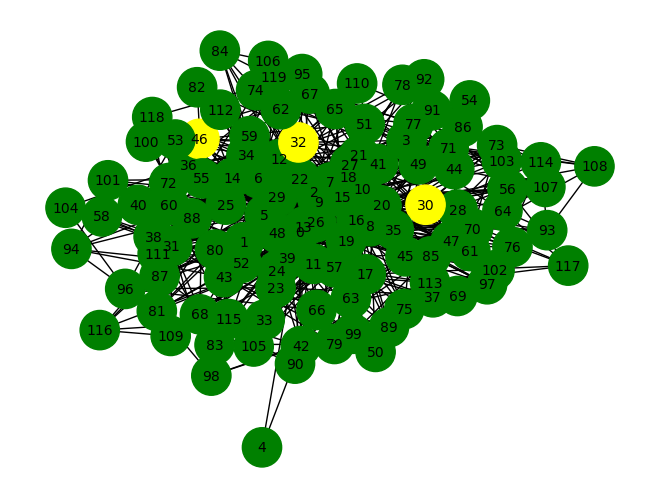

In [4]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [5]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [6]:
data = optimize_and_collect(instance)

[2025-02-09 18:23:57][  0]     0.41349435     0.41297388 { 58.00000000  77.19400000 211.00000000  30.44365885}
[2025-02-09 18:23:58][  1]     0.78757596     0.36596155 { 60.00000000  75.71600000 194.00000000  27.53127937}
[2025-02-09 18:23:58][  2]     1.06179571     0.26725793 { 59.00000000  75.62600000 197.00000000  27.56167854}
[2025-02-09 18:23:58][  3]     1.45735884     0.38496208 { 60.00000000  75.67600000 203.00000000  28.80623238}
[2025-02-09 18:23:59][  4]     1.88370156     0.42240548 { 60.00000000  73.28600000 199.00000000  22.72796084}
[2025-02-09 18:23:59][  5]     2.17129946     0.28491306 { 60.00000000  72.91000000 196.00000000  23.22700799}
[2025-02-09 18:24:00][  6]     2.52270675     0.34596109 { 61.00000000  74.40200000 198.00000000  25.63350144}
[2025-02-09 18:24:00][  7]     2.75507593     0.22839117 { 59.00000000  74.06800000 201.00000000  25.03819834}
[2025-02-09 18:24:00][  8]     3.00281048     0.24508286 { 60.00000000  76.07400000 198.00000000  28.69516552}
[

In [7]:
solutions = correct_solutions(instance)

## Results

In [8]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [2]:
[0, 10, 20, 24, 27, 30, 42, 47, 48, 54, 55, 63, 68, 70, 71, 73, 78, 80, 88, 89, 90, 96, 100, 101, 103, 109, 114, 116, 117, 118]


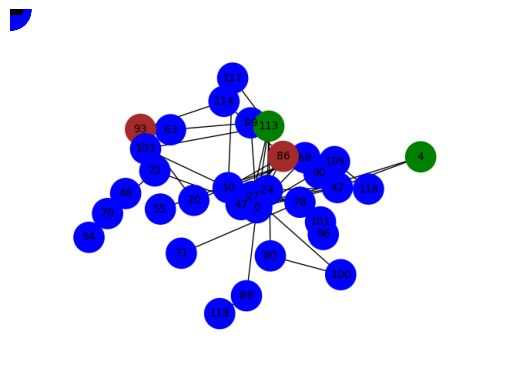

In [9]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

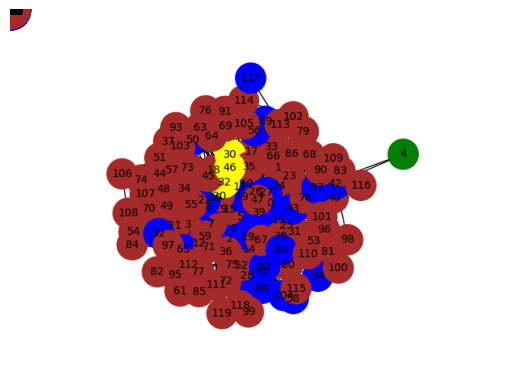

In [10]:
instance.problem.visualize_fires(displayer, solutions)

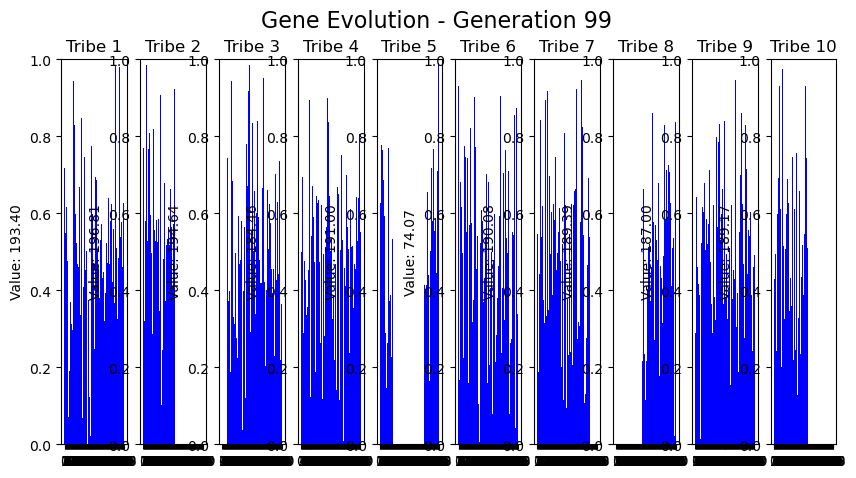

In [11]:
gene_displayer.visualize(data)

## Instance 200

data collected


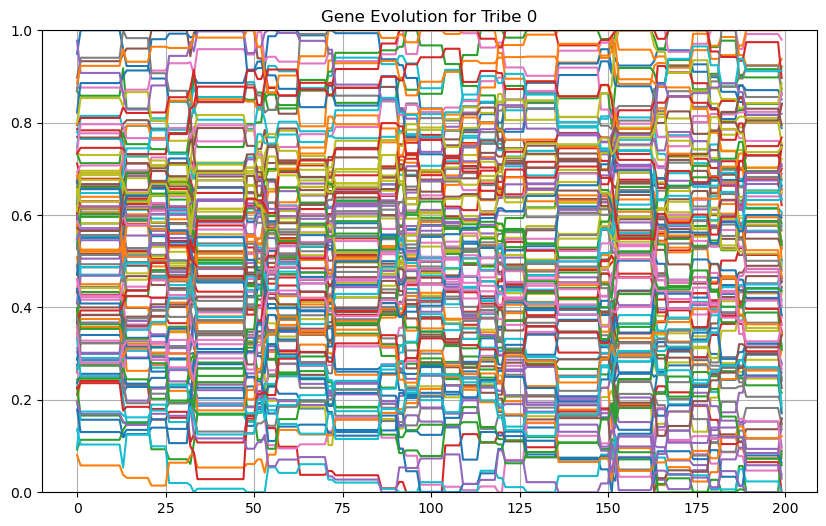

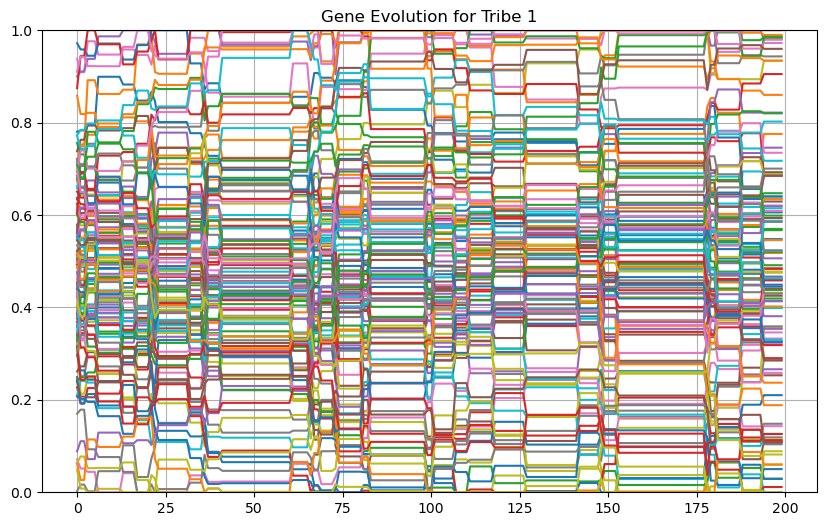

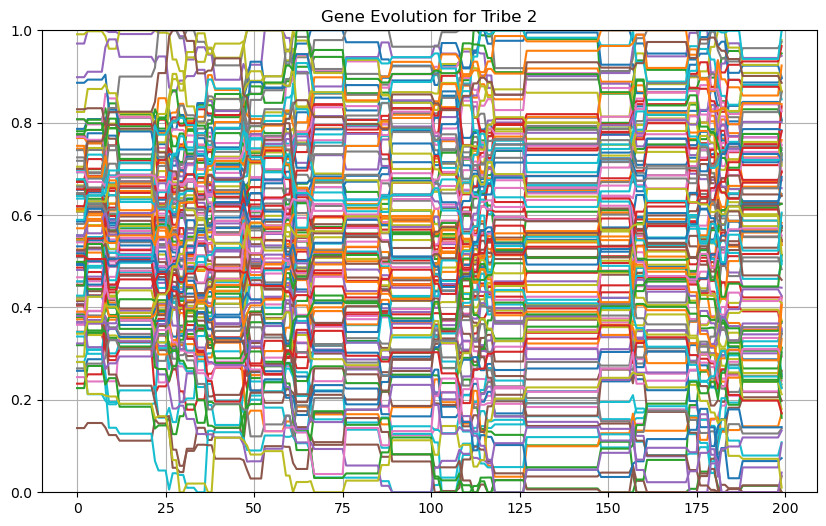

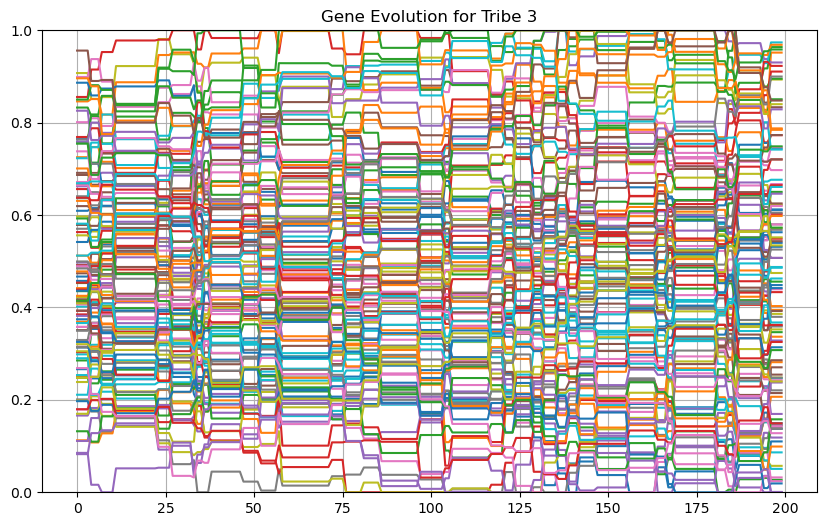

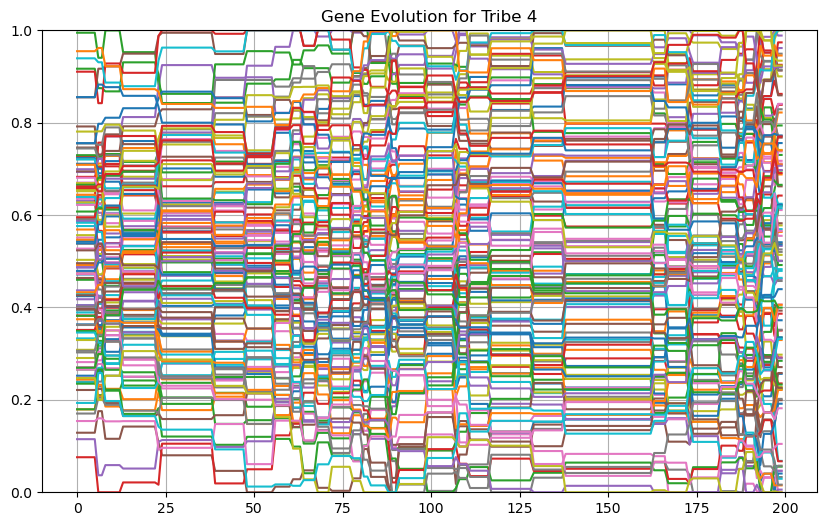

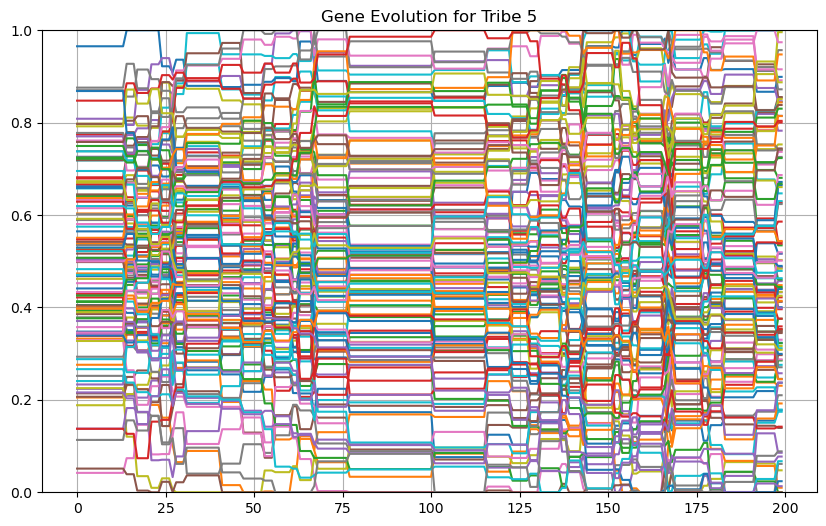

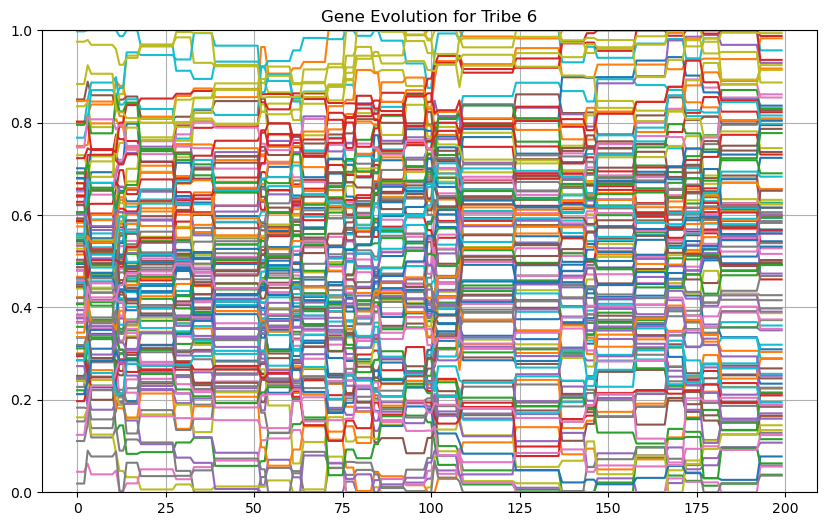

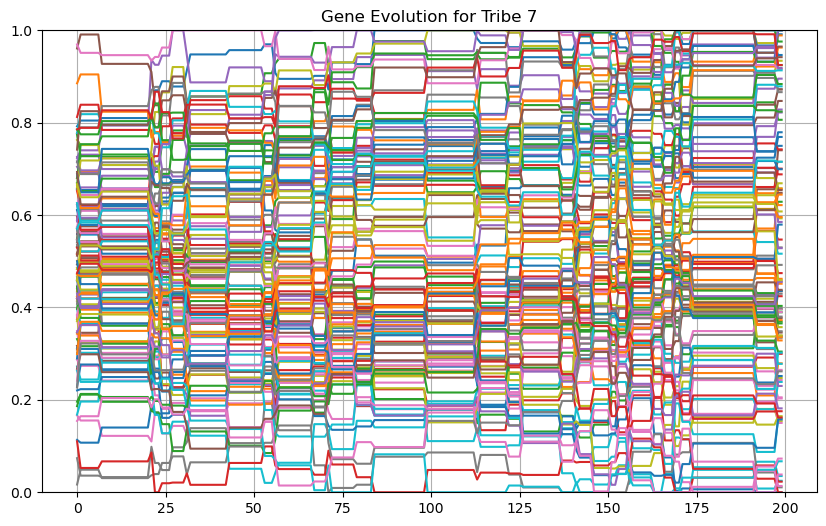

In [12]:
data200, instance200 = collect_and_visualize("../problems/p8.json", local_step_size=0.03, sigma=0.04)

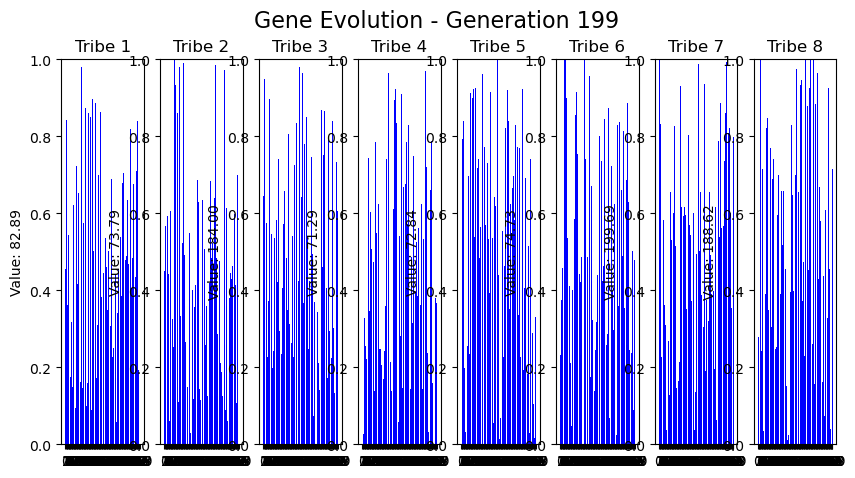

In [13]:
gene_displayer.visualize(data200)

In [14]:
solutions = correct_solutions(instance200)

In [15]:
best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")

Best solution [2]:
[0, 2, 10, 13, 14, 26, 27, 29, 32, 42, 43, 47, 52, 56, 58, 59, 62, 64, 66, 71, 74, 76, 77, 79, 85, 89, 91, 103, 108, 109]
